In [1]:
import numpy as np
import cv2
import scipy.io
import os
from numpy.linalg import norm
from matplotlib import pyplot as plt
from numpy.linalg import det
from numpy.linalg import inv
from scipy.linalg import rq
from numpy.linalg import svd
import matplotlib.pyplot as plt
import numpy as np
import math
import random
import sys
from scipy import ndimage, spatial
from tqdm.notebook import tqdm, trange


In [2]:
from google.colab import drive

# This will prompt for authorization.
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:

class Image:
    def __init__(self, img, position):
        
        self.img = img
        self.position = position

inlier_matchset = []
def features_matching(a,keypointlength,threshold):
  #threshold=0.2
  bestmatch=np.empty((keypointlength),dtype= np.int16)
  img1index=np.empty((keypointlength),dtype=np.int16)
  distance=np.empty((keypointlength))
  index=0
  for j in range(0,keypointlength):
    #For a descriptor fa in Ia, take the two closest descriptors fb1 and fb2 in Ib
    x=a[j]
    listx=x.tolist()
    x.sort()
    minval1=x[0]                                # min 
    minval2=x[1]                                # 2nd min
    itemindex1 = listx.index(minval1)           #index of min val    
    itemindex2 = listx.index(minval2)           #index of second min value 
    ratio=minval1/minval2                       #Ratio Test
    
    if ratio<threshold: 
      #Low distance ratio: fb1 can be a good match
      bestmatch[index]=itemindex1
      distance[index]=minval1
      img1index[index]=j
      index=index+1
  return  [cv2.DMatch(img1index[i],bestmatch[i].astype(int),distance[i]) for i in range(0,index)]
          
   
  
def compute_Homography(im1_pts,im2_pts):
  """
  im1_pts and im2_pts are 2×n matrices with
  4 point correspondences from the two images
  """
  num_matches=len(im1_pts)
  num_rows = 2 * num_matches
  num_cols = 9
  A_matrix_shape = (num_rows,num_cols)
  A = np.zeros(A_matrix_shape)
  a_index = 0
  for i in range(0,num_matches):
    (a_x, a_y) = im1_pts[i]
    (b_x, b_y) = im2_pts[i]
    row1 = [a_x, a_y, 1, 0, 0, 0, -b_x*a_x, -b_x*a_y, -b_x] # First row 
    row2 = [0, 0, 0, a_x, a_y, 1, -b_y*a_x, -b_y*a_y, -b_y] # Second row 

    # place the rows in the matrix
    A[a_index] = row1
    A[a_index+1] = row2

    a_index += 2
    
  U, s, Vt = np.linalg.svd(A)

  #s is a 1-D array of singular values sorted in descending order
  #U, Vt are unitary matrices
  #Rows of Vt are the eigenvectors of A^TA.
  #Columns of U are the eigenvectors of AA^T.
  H = np.eye(3)
  H = Vt[-1].reshape(3,3) # take the last row of the Vt matrix
  return H
  
  
def displayplot(img,title):
  
  plt.figure(figsize=(15,15))
  plt.title(title)
  plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  plt.show()
  


In [4]:

def RANSAC_alg(f1, f2, matches, nRANSAC, RANSACthresh):

      
    minMatches = 4
    nBest = 0
    best_inliers = []
    H_estimate = np.eye(3,3)
    global inlier_matchset
    inlier_matchset=[]
    for iteration in range(nRANSAC):
      
        #Choose a minimal set of feature matches.
        matchSample = random.sample(matches, minMatches)
        
        #Estimate the Homography implied by these matches
        im1_pts=np.empty((minMatches,2))
        im2_pts=np.empty((minMatches,2))
        for i in range(0,minMatches):
          m = matchSample[i]
          im1_pts[i] = f1[m.queryIdx].pt
          im2_pts[i] = f2[m.trainIdx].pt
          #im1_pts[i] = f1[m[0]].pt
          #im2_pts[i] = f2[m[1]].pt             
          
        H_estimate=compute_Homography(im1_pts,im2_pts)
        
               
        # Calculate the inliers for the H
        inliers = get_inliers(f1, f2, matches, H_estimate, RANSACthresh)

        # if the number of inliers is higher than previous iterations, update the best estimates
        if len(inliers) > nBest:
            nBest= len(inliers)
            best_inliers = inliers

    print("Number of best inliers",len(best_inliers))
    for i in range(len(best_inliers)):
      inlier_matchset.append(matches[best_inliers[i]])
    
    # compute a homography given this set of matches
    im1_pts=np.empty((len(best_inliers),2))
    im2_pts=np.empty((len(best_inliers),2))
    for i in range(0,len(best_inliers)):
      m = inlier_matchset[i]
      im1_pts[i] = f1[m.queryIdx].pt
      im2_pts[i] = f2[m.trainIdx].pt
      #im1_pts[i] = f1[m[0]].pt
      #im2_pts[i] = f2[m[1]].pt

    M=compute_Homography(im1_pts,im2_pts)
    return M




In [5]:

def get_inliers(f1, f2, matches, H, RANSACthresh):

  inlier_indices = []
  for i in range(len(matches)):
    queryInd = matches[i].queryIdx
    trainInd = matches[i].trainIdx

    #queryInd = matches[i][0]
    #trainInd = matches[i][1]

    queryPoint = np.array([f1[queryInd].pt[0],  f1[queryInd].pt[1], 1]).T 
    trans_query = H.dot(queryPoint) 

   
    comp1 = [trans_query[0]/trans_query[2], trans_query[1]/trans_query[2]] # normalize with respect to z
    comp2 = np.array(f2[trainInd].pt)[:2]
    

    if(np.linalg.norm(comp1-comp2) <= RANSACthresh): # check against threshold
      inlier_indices.append(i)
  return inlier_indices


def ImageBounds(img, H):

    h, w= img.shape[0], img.shape[1]
    p1 = np.dot(H, np.array([0, 0, 1]))
    p2 = np.dot(H, np.array([0, h - 1, 1]))
    p3 = np.dot(H, np.array([w - 1, 0, 1]))
    p4 = np.dot(H, np.array([w - 1, h - 1, 1]))
    x1 = p1[0] / p1[2]
    y1 = p1[1] / p1[2]
    x2 = p2[0] / p2[2]
    y2 = p2[1] / p2[2]
    x3 = p3[0] / p3[2]
    y3 = p3[1] / p3[2]
    x4 = p4[0] / p4[2]
    y4 = p4[1] / p4[2]
    minX = math.ceil(min(x1, x2, x3, x4))
    minY = math.ceil(min(y1, y2, y3, y4))
    maxX = math.ceil(max(x1, x2, x3, x4))
    maxY = math.ceil(max(y1, y2, y3, y4))

    return int(minX), int(minY), int(maxX), int(maxY)
  
  
def Populate_Images(img, accumulator, H, bw):
  


    h, w = img.shape[0], img.shape[1]
    minX, minY, maxX, maxY = ImageBounds(img, H)

    for i in range(minX, maxX + 1):
        for j in range(minY, maxY + 1):
            p = np.dot(np.linalg.inv(H), np.array([i, j, 1]))

            x = p[0]
            y = p[1]
            z = p[2]

            _x = int(x / z)
            _y = int(y / z)

            if _x < 0 or _x >= w - 1 or _y < 0 or _y >= h - 1:
                continue

            if img[_y, _x, 0] == 0 and img[_y, _x, 1] == 0 and img[_y, _x, 2] == 0:
                continue

            wt = 1.0

            if _x >= minX and _x < minX + bw:
                wt = float(_x - minX) /bw
            if _x <= maxX and _x > maxX -bw:
                wt = float(maxX - _x) /bw

            accumulator[j, i, 3] += wt

            for c in range(3):
                accumulator[j, i, c] += img[_y, _x, c] *wt


  

In [6]:

def Image_Stitch(Imagesall, blendWidth, accWidth, accHeight, translation):
    channels=3
    #width=720

    acc = np.zeros((accHeight, accWidth, channels + 1))
    M = np.identity(3)
    for count, i in enumerate(Imagesall):
        M = i.position
        img = i.img
        M_trans = translation.dot(M)
        Populate_Images(img, acc, M_trans, blendWidth)
    
    height, width = acc.shape[0], acc.shape[1]

    img = np.zeros((height, width, 3))
    for i in range(height):
        for j in range(width):
            weights = acc[i, j, 3]
            if weights > 0:
                for c in range(3):
                    img[i, j, c] = int(acc[i, j, c] / weights)
                    

    Imagefull = np.uint8(img)
    M = np.identity(3)
    for count, i in enumerate(Imagesall):
        if count != 0 and count != (len(Imagesall) - 1):
            continue

        M = i.position

        M_trans = translation.dot(M)

        p = np.array([0.5 * width, 0, 1])
        p = M_trans.dot(p)

        
        if count == 0:
            x_init, y_init = p[:2] / p[2]
        
        if count == (len(Imagesall) - 1):
            x_final, y_final = p[:2] / p[2]
    
    
    A = np.identity(3)
    croppedImage = cv2.warpPerspective(
        Imagefull, A, (accWidth, accHeight), flags=cv2.INTER_LINEAR
    )
    displayplot(croppedImage, 'Final Stitched Image')



In [8]:
files_all = os.listdir('/content/drive/MyDrive/RGB-img/img/')
files_all.sort()
folder_path = '/content/drive/MyDrive/RGB-img/img/'

centre_file = folder_path + files_all[15]
left_files_path_rev = []
right_files_path = []

for file in files_all[1:16]:
  left_files_path_rev.append(folder_path + file)

left_files_path = left_files_path_rev[::-1]

for file in files_all[14:30]:
  right_files_path.append(folder_path + file)


In [9]:
from PIL import Image, ExifTags
img = Image.open(f"{left_files_path[0]}")
exif = { ExifTags.TAGS[k]: v for k, v in img._getexif().items() if k in ExifTags.TAGS }
from PIL.ExifTags import TAGS

def get_exif(filename):
    image = Image.open(filename)
    image.verify()
    return image._getexif()
    
def get_labeled_exif(exif):
    labeled = {}
    for (key, val) in exif.items():
        labeled[TAGS.get(key)] = val

    return labeled

exif = get_exif(f"{left_files_path[0]}")
labeled = get_labeled_exif(exif)
print(labeled)
from PIL.ExifTags import GPSTAGS

def get_geotagging(exif):
    if not exif:
        raise ValueError("No EXIF metadata found")

    geotagging = {}
    for (idx, tag) in TAGS.items():
        if tag == 'GPSInfo':
            if idx not in exif:
                raise ValueError("No EXIF geotagging found")

            for (key, val) in GPSTAGS.items():
                if key in exif[idx]:
                    geotagging[val] = exif[idx][key]
    return geotagging
all_files_path = left_files_path[::-1] + right_files_path[1:]
for file1 in all_files_path:
  exif = get_exif(f"{file1}")
  geotags = get_geotagging(exif)
def get_decimal_from_dms(dms, ref):

    degrees = dms[0][0] / dms[0][1]
    minutes = dms[1][0] / dms[1][1] / 60.0
    seconds = dms[2][0] / dms[2][1] / 3600.0

    if ref in ['S', 'W']:
        degrees = -degrees
        minutes = -minutes
        seconds = -seconds

    return round(degrees + minutes + seconds, 5)

def get_coordinates(geotags):
    lat = get_decimal_from_dms(geotags['GPSLatitude'], geotags['GPSLatitudeRef'])

    lon = get_decimal_from_dms(geotags['GPSLongitude'], geotags['GPSLongitudeRef'])

    return (lat,lon)
all_geocoords = []
plt.figure(figsize = (20,10))
for file1 in all_files_path:
  exif = get_exif(f"{file1}")
  geotags = get_geotagging(exif)
  #print(get_coordinates(geotags))
  geocoord = get_coordinates(geotags)
  all_geocoords.append(geocoord)


{'ExifVersion': b'0230', 'ApertureValue': (497, 100), 'DateTimeOriginal': '2018:09:02 05:24:57', 'ExposureBiasValue': (0, 10), 'MaxApertureValue': (297, 100), 'SubjectDistance': (4294967295, 1000), 'MeteringMode': 1, 'LightSource': 9, 'Flash': 16, 'FocalLength': (185, 10), 'ExifImageWidth': 6000, 'ExifImageHeight': 4000, 'FlashEnergy': (0, 0), 'FocalPlaneXResolution': (2558, 1), 'FocalPlaneYResolution': (2558, 1), 'FocalPlaneResolutionUnit': 3, 'SubsecTimeOriginal': '00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00', 'ProcessingSoftware': 'eMotion 3.7.0b2', 'Make': 'senseFly', 'Model': 'senseFly Aeria X', 'UniqueCameraModel': 'senseFly Aeria X', 'ExposureTime': (10, 20000), 'XResolution': (72, 1), 'YResolution': (72, 1), 'FNumber': (56, 10), 'ExposureProgram': 4, 'GPSInfo': {0: b'\x02\x03\x00\x00', 1: 'N', 2: ((14, 1), (4, 1), (16302509, 1000000)), 3: 'E', 4: ((100, 1), (37, 1), (5027233, 1000000)), 5: b'\x00', 6: (2541414, 10000), 7: ((5, 1), (24, 1), (57643, 100

<Figure size 1440x720 with 0 Axes>

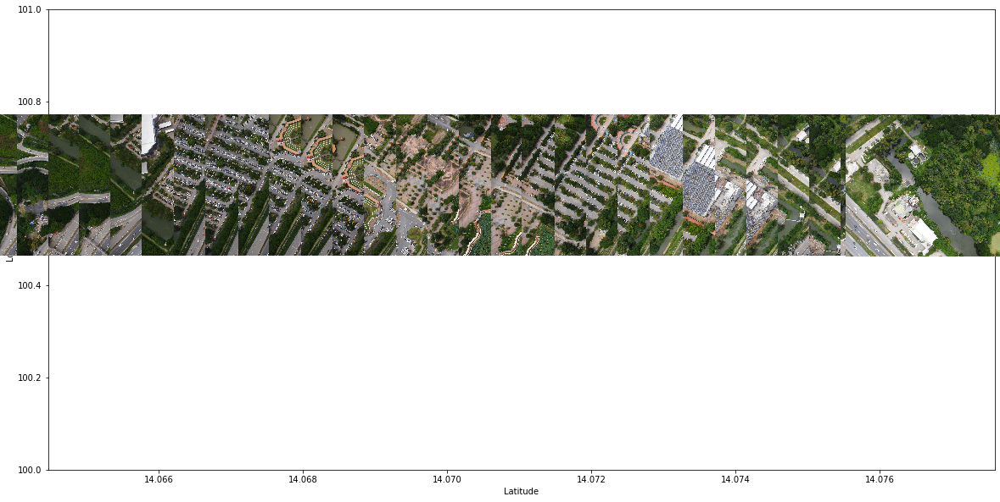

In [10]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

fig, ax = plt.subplots()
fig.set_size_inches(20,10)
ax.set_xlabel('Latitude')
ax.set_ylabel('Longitude')
ax.set_ylim(100,101)
#ax.set_xlim(12,16)

len1 = 50
ax.plot(np.array(all_geocoords)[:len1,0], np.array(all_geocoords)[:len1,1],linestyle='None')

def aerial_images_register(x, y,ax=None):
    ax = ax or plt.gca()
    for count,points in enumerate(zip(x,y)):
        lat,lon = points
        image = plt.imread(all_files_path[count])
        #print(ax.figure.dpi)
        im = OffsetImage(image, zoom=3/ax.figure.dpi)
        im.image.axes = ax
        ab = AnnotationBbox(im, (lat,lon), frameon=False, pad=0.0,)

        ax.add_artist(ab)

aerial_images_register(np.array(all_geocoords)[:len1,0], np.array(all_geocoords)[:len1,1], ax=ax)

In [11]:

images_left = []
images_right = []


for file in tqdm(left_files_path):
  left_image_sat= cv2.imread(file)
  left_img = cv2.resize(left_image_sat,None,fx=0.35, fy=0.35, interpolation = cv2.INTER_CUBIC)
  images_left.append(left_img)


for file in tqdm(right_files_path):
  right_image_sat= cv2.imread(file)
  right_img = cv2.resize(right_image_sat,None,fx=0.35, fy=0.35, interpolation = cv2.INTER_CUBIC)
  images_right.append(right_img)



In [12]:
#brisk = cv2.KAZE_create()
Threshl=60;
Octaves=6; 
#PatternScales=1.0f;
brisk = cv2.BRISK_create(Threshl,Octaves)
#brisk = cv2.SIFT_create()
#brisk = cv2.AKAZE_create()


keypoints_all_left = []
descriptors_all_left = []
points_all_left=[]

keypoints_all_right = []
descriptors_all_right = []
points_all_right=[]

for imgs in tqdm(images_left):
  kpt = brisk.detect(imgs,None)
  kpt,descrip =  brisk.compute(imgs, kpt)
  keypoints_all_left.append(kpt)
  descriptors_all_left.append(descrip)
  points_all_left.append(np.asarray([[p.pt[0], p.pt[1]] for p in kpt]))

for imgs in tqdm(images_right):
  kpt = brisk.detect(imgs,None)
  kpt,descrip =  brisk.compute(imgs, kpt)
  keypoints_all_right.append(kpt)
  descriptors_all_right.append(descrip)
  points_all_right.append(np.asarray([[p.pt[0], p.pt[1]] for p in kpt]))

In [13]:
def get_Hmatrix(imgs,keypts,pts,descripts,disp=True):
  #FLANN_INDEX_KDTREE = 1
  #index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
  #search_params = dict(checks=50)
  #flann = cv2.FlannBasedMatcher(index_params, search_params)
  flann = cv2.BFMatcher()



  lff1 = np.float32(descripts[0])
  lff = np.float32(descripts[1])


  matches_lf1_lf = flann.knnMatch(lff1, lff, k=2)

  #print(len(matches_lf1_lf))

  matches_4 = []
  ratio = 0.8
  # loop over the raw matches
  for m in matches_lf1_lf:
    # ensure the distance is within a certain ratio of each
    # other (i.e. Lowe’s ratio test)
    if len(m) == 2 and m[0].distance < m[1].distance * ratio:
        #matches_1.append((m[0].trainIdx, m[0].queryIdx))
        matches_4.append(m[0])

  print("Number of matches",len(matches_4))

  # Estimate homography 1
  #Compute H1
  imm1_pts=np.empty((len(matches_4),2))
  imm2_pts=np.empty((len(matches_4),2))
  for i in range(0,len(matches_4)):
    m = matches_4[i]
    (a_x, a_y) = keypts[0][m.queryIdx].pt
    (b_x, b_y) = keypts[1][m.trainIdx].pt
    imm1_pts[i]=(a_x, a_y)
    imm2_pts[i]=(b_x, b_y)    
  H=compute_Homography(imm1_pts,imm2_pts) 
  #Robustly estimate Homography 1 using RANSAC
  Hn=RANSAC_alg(keypts[0] ,keypts[1], matches_4,  nRANSAC=1500, RANSACthresh=6)
  global inlier_matchset   

  if disp==True:
    dispimg1=cv2.drawMatches(imgs[0], keypts[0], imgs[1], keypts[1], inlier_matchset, None,flags=2)
    displayplot(dispimg1,'Robust Matching between Reference Image and Right Image ')

  return Hn/Hn[2,2]






Number of matches 2043
Number of best inliers 1430


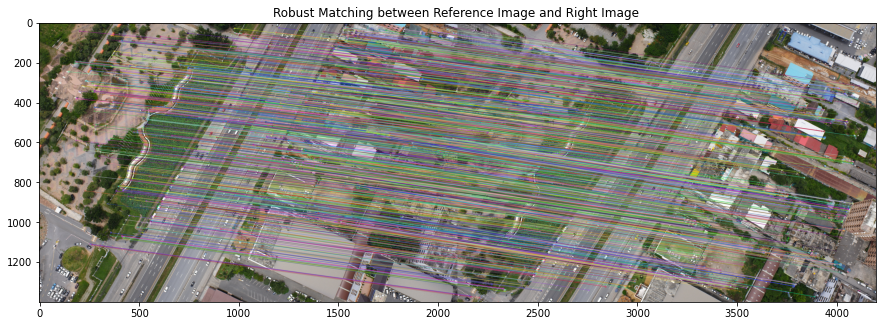

Number of matches 2027
Number of best inliers 1412


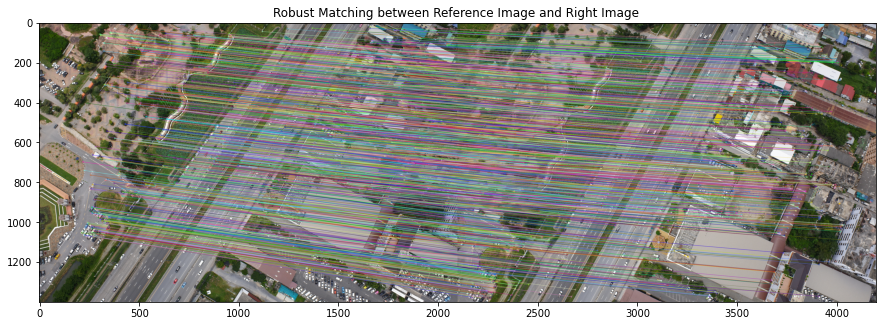

Number of matches 1496
Number of best inliers 1099


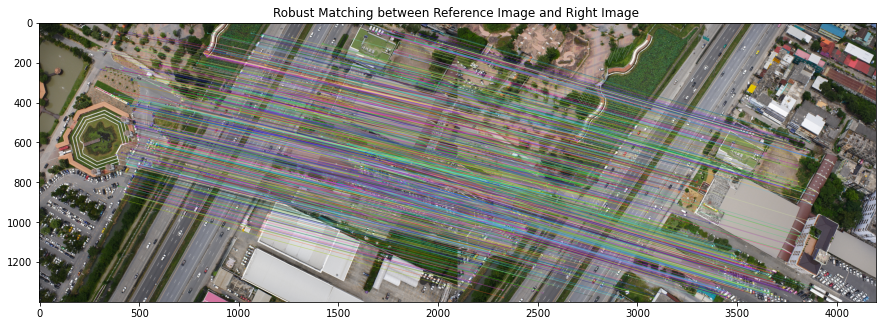

Number of matches 2912
Number of best inliers 2433


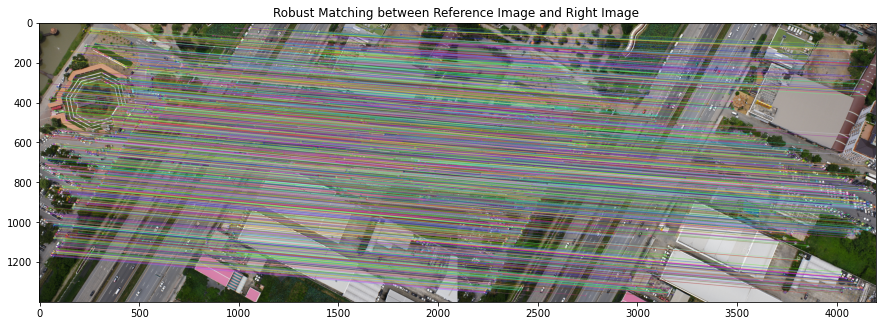

Number of matches 2779
Number of best inliers 2306


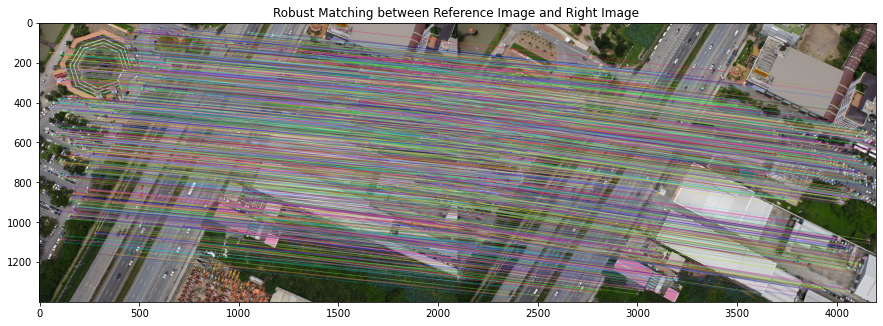

Number of matches 1432
Number of best inliers 1160


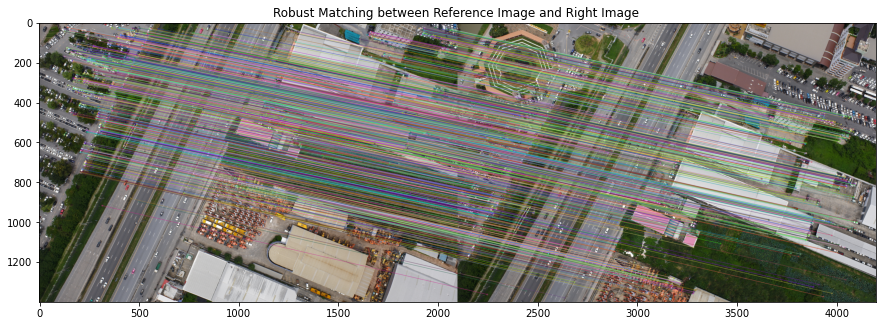

Number of matches 1243
Number of best inliers 1039


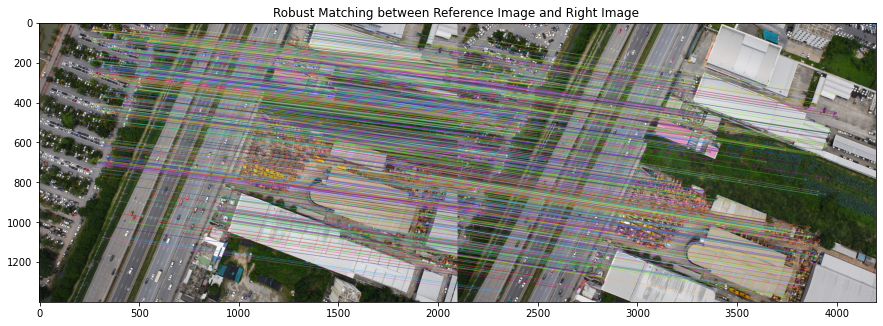

Number of matches 1750
Number of best inliers 1443


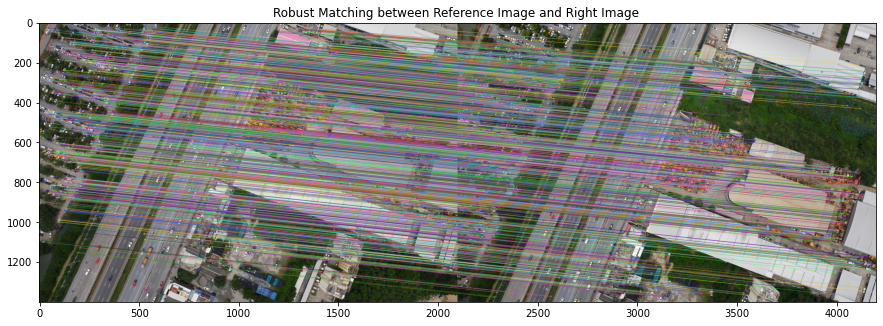

Number of matches 1515
Number of best inliers 1056


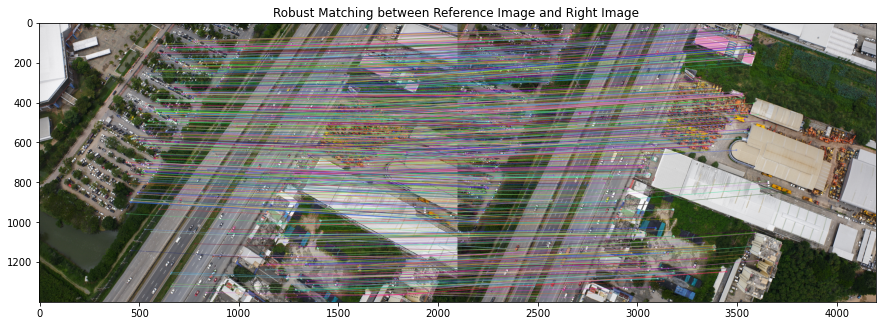

Number of matches 1519
Number of best inliers 1234


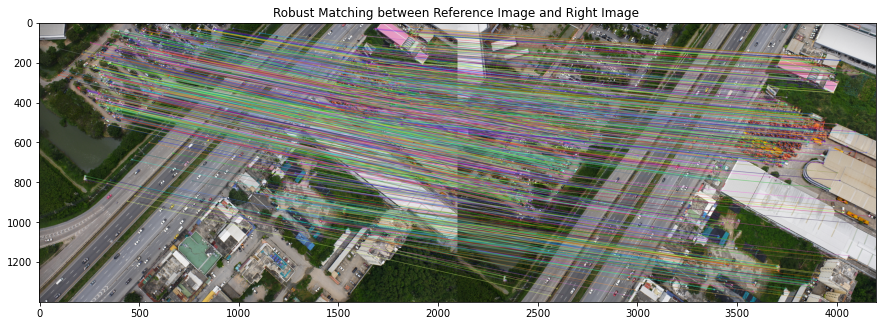

Number of matches 1254
Number of best inliers 767


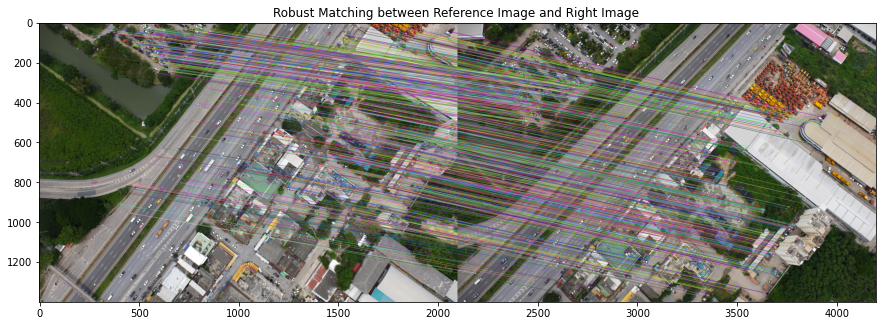

Number of matches 2161
Number of best inliers 1302


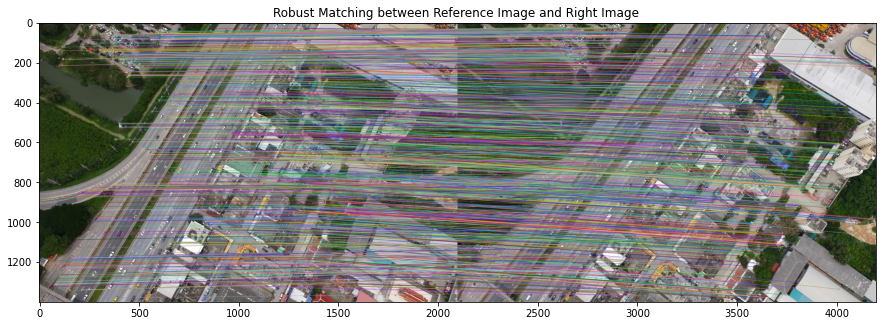

Number of matches 1080
Number of best inliers 560


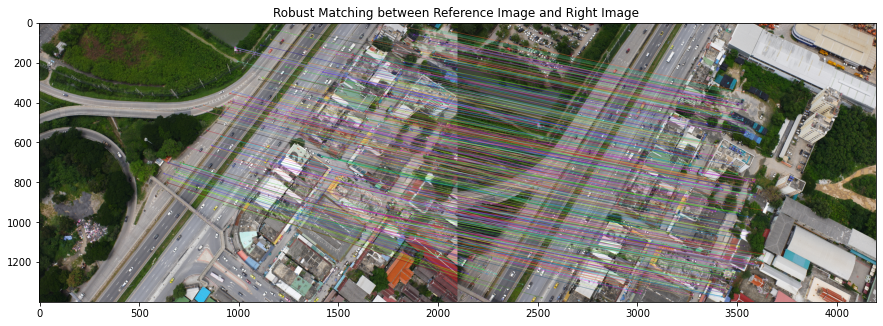

Number of matches 1742
Number of best inliers 931


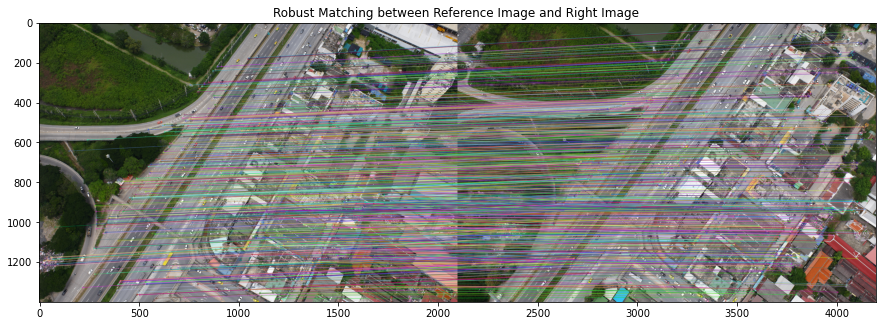

Number of matches 2102
Number of best inliers 1477


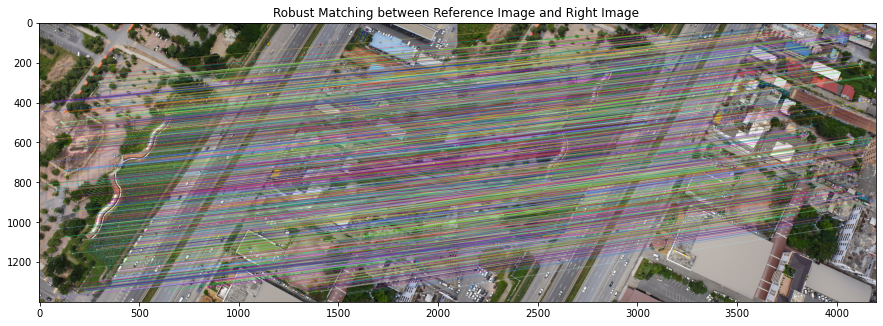

Number of matches 2174
Number of best inliers 1607


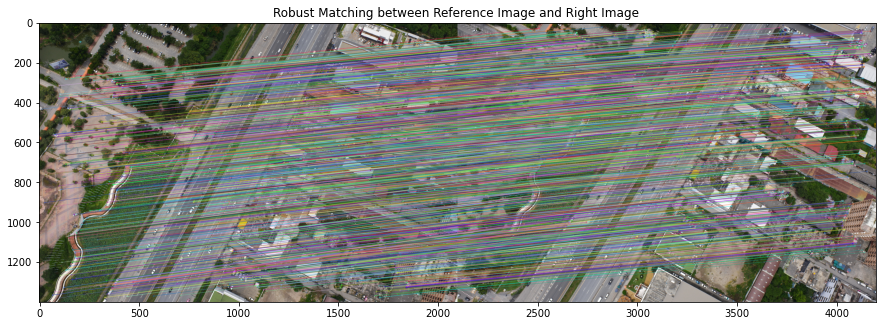

Number of matches 2013
Number of best inliers 1661


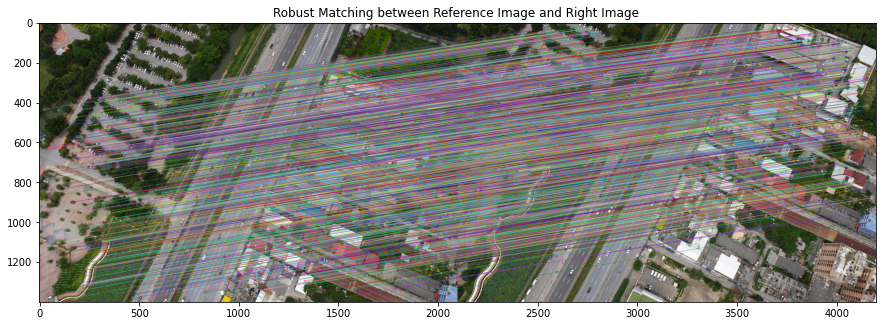

Number of matches 2284
Number of best inliers 1965


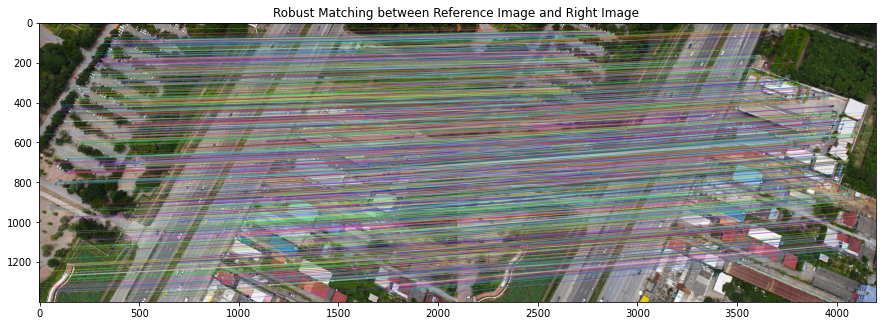

Number of matches 2051
Number of best inliers 1712


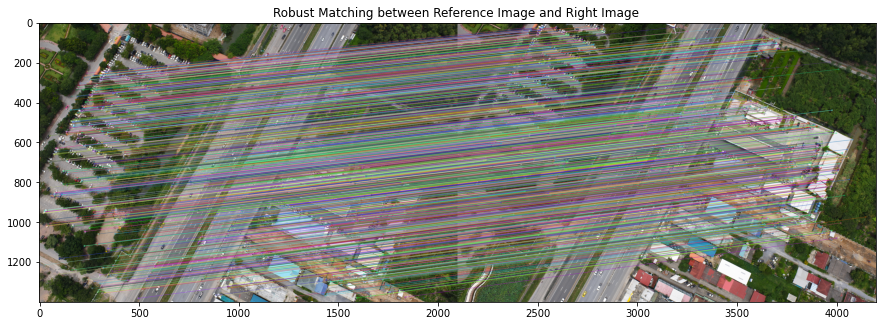

Number of matches 1760
Number of best inliers 1513


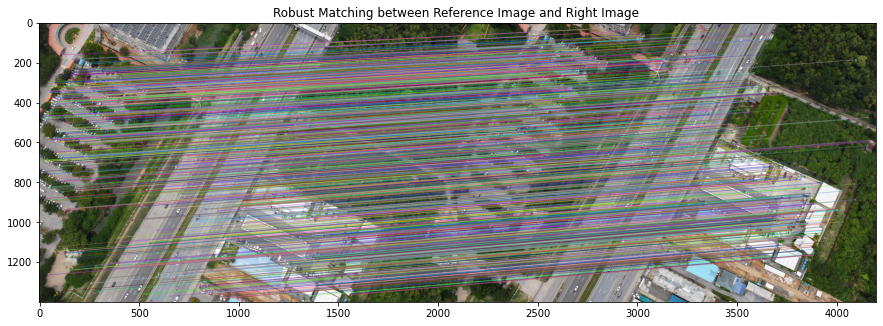

Number of matches 1398
Number of best inliers 1094


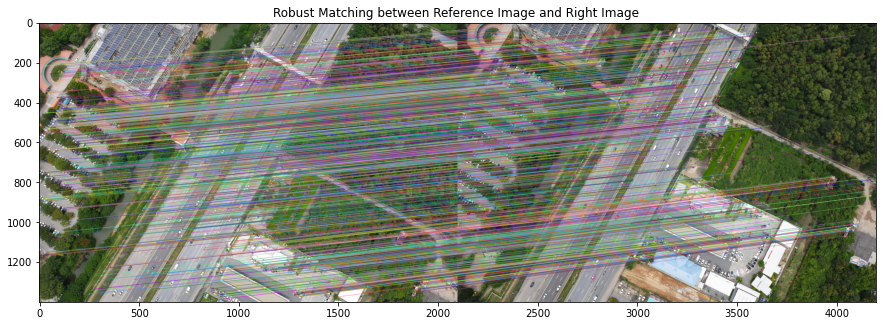

Number of matches 923
Number of best inliers 546


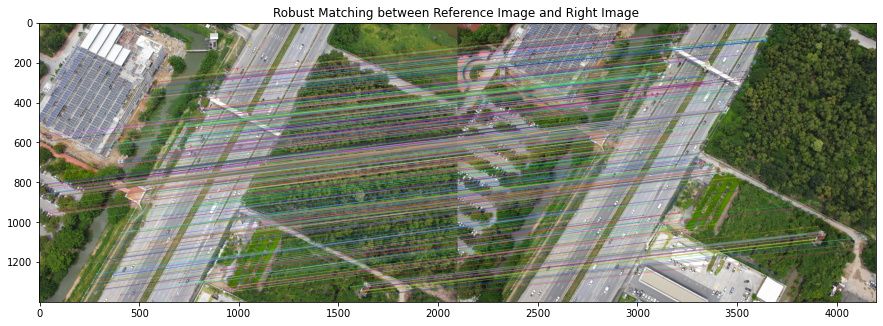

Number of matches 1054
Number of best inliers 459


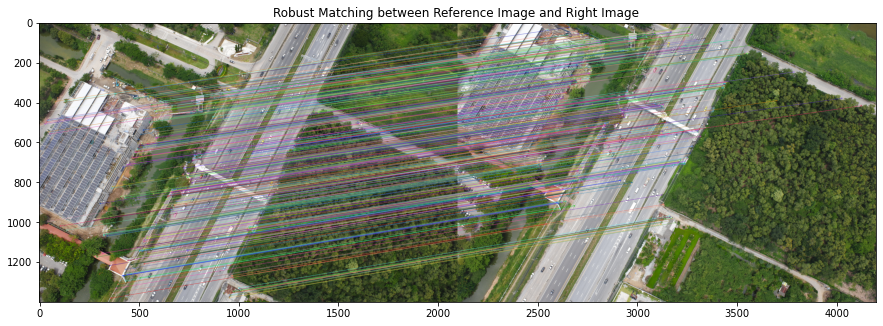

Number of matches 697
Number of best inliers 444


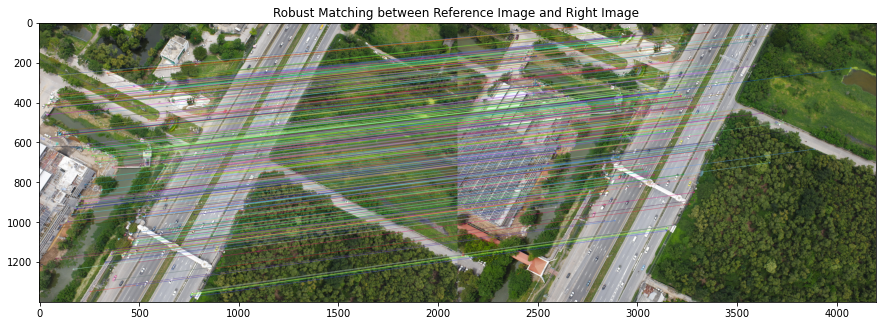

Number of matches 1033
Number of best inliers 704


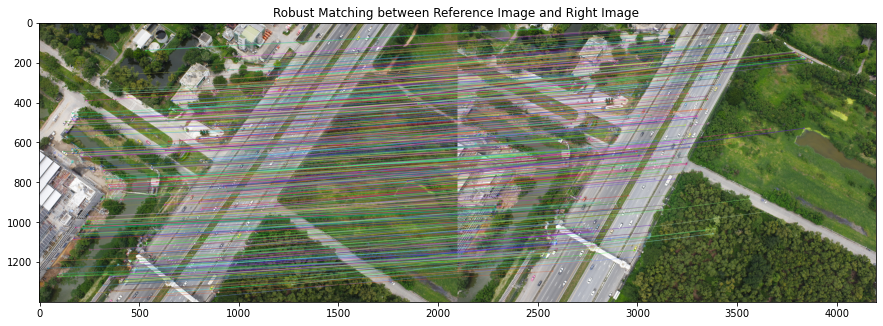

Number of matches 746
Number of best inliers 553


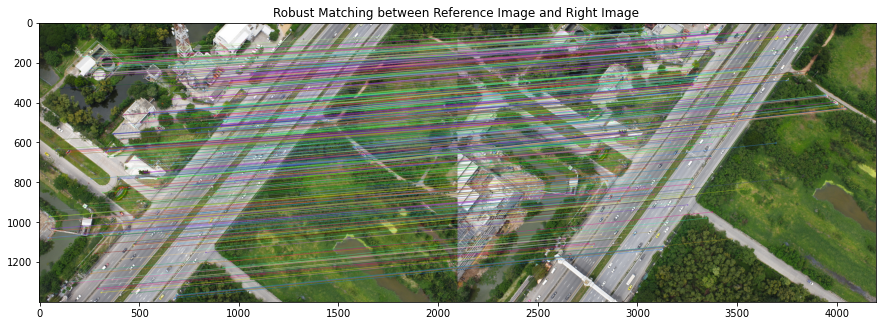

Number of matches 1053
Number of best inliers 754


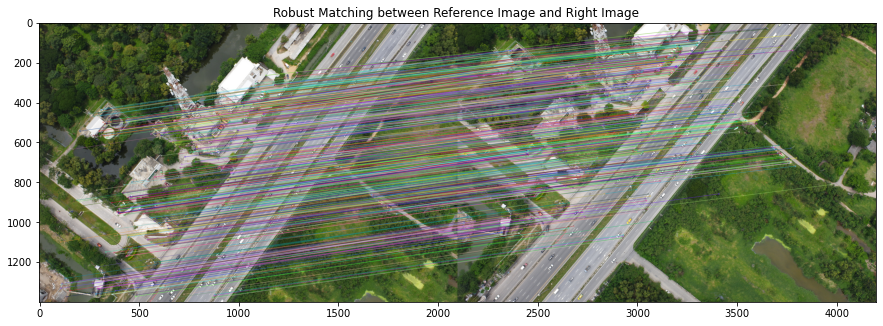

Number of matches 920
Number of best inliers 633


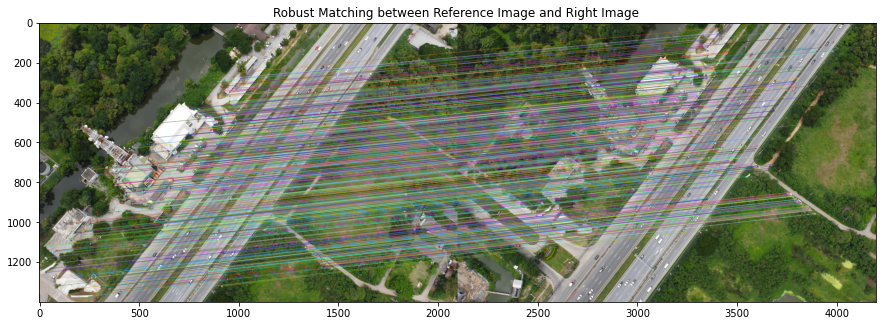

Number of matches 99
Number of best inliers 39


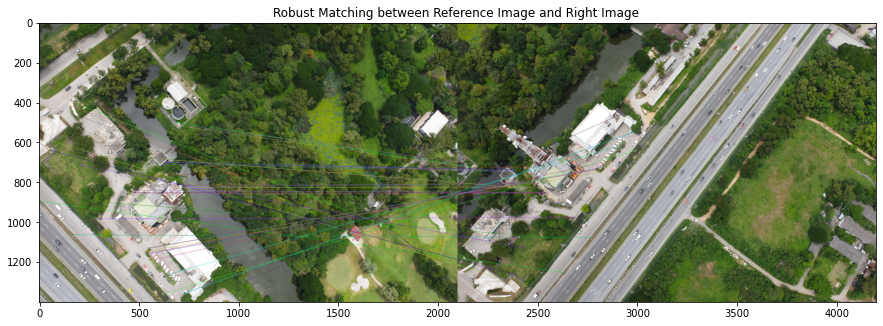

In [14]:
H_left = []
H_right = []

for j in tqdm(range(len(images_left))):
  if j==len(images_left)-1:
    break

  H_a = get_Hmatrix(images_left[j:j+2][::-1],keypoints_all_left[j:j+2][::-1],points_all_left[j:j+2][::-1],descriptors_all_left[j:j+2][::-1])
  H_left.append(H_a)

for j in tqdm(range(len(images_right))):
  if j==len(images_right)-1:
    break

  H_a = get_Hmatrix(images_right[j:j+2][::-1],keypoints_all_right[j:j+2][::-1],points_all_right[j:j+2][::-1],descriptors_all_right[j:j+2][::-1])
  H_right.append(H_a)


In [15]:
def warpnImages(images_left, images_right,H_left,H_right):
    #img1-centre,img2-left,img3-right

    h, w = images_left[0].shape[:2]

    pts_left = []
    pts_right = []

    pts_centre = np.float32([[0, 0], [0, h], [w, h], [w, 0]]).reshape(-1, 1, 2)

    for j in range(len(H_left)):
      pts = np.float32([[0, 0], [0, h], [w, h], [w, 0]]).reshape(-1, 1, 2)
      pts_left.append(pts)

    for j in range(len(H_right)):
      pts = np.float32([[0, 0], [0, h], [w, h], [w, 0]]).reshape(-1, 1, 2)
      pts_right.append(pts)

    pts_left_transformed=[]
    pts_right_transformed=[]

    for j,pts in enumerate(pts_left):
      if j==0:
        H_trans = H_left[j]
      else:
        H_trans = H_trans@H_left[j]
      pts_ = cv2.perspectiveTransform(pts, H_trans)
      pts_left_transformed.append(pts_)

    for j,pts in enumerate(pts_right):
      if j==0:
        H_trans = H_right[j]
      else:
        H_trans = H_trans@H_right[j]
      pts_ = cv2.perspectiveTransform(pts, H_trans)
      pts_right_transformed.append(pts_)



    #pts = np.concatenate((pts1, pts2_), axis=0)

    pts_concat = np.concatenate((pts_centre,np.concatenate(np.array(pts_left_transformed),axis=0),np.concatenate(np.array(pts_right_transformed),axis=0)), axis=0)

    [xmin, ymin] = np.int32(pts_concat.min(axis=0).ravel() - 0.5)
    [xmax, ymax] = np.int32(pts_concat.max(axis=0).ravel() + 0.5)
    t = [-xmin, -ymin]
    Ht = np.array([[1, 0, t[0]], [0, 1, t[1]], [0, 0, 1]])  # translate

    print('Step2:Done')

    warp_imgs_left = []
    warp_imgs_right = []


    for j,H in enumerate(H_left):
      if j==0:
        H_trans = Ht@H
      else:
        H_trans = H_trans@H
      result = cv2.warpPerspective(images_left[j+1], H_trans, (xmax-xmin, ymax-ymin))

      if j==0:
        result[t[1]:h+t[1], t[0]:w+t[0]] = images_left[0]
      
      warp_imgs_left.append(result)


    for j,H in enumerate(H_right):
      if j==0:
        H_trans = Ht@H
      else:
        H_trans = H_trans@H
      result = cv2.warpPerspective(images_right[j+1], H_trans, (xmax-xmin, ymax-ymin))
      
      warp_imgs_right.append(result)

    print('Step3:Done')

    #Union

    warp_images_all = warp_imgs_left + warp_imgs_right

    warp_img_init = warp_images_all[0]

    warp_final_all=[]


    for j,warp_img in enumerate(warp_images_all):
      if j==len(warp_images_all)-1:
        break
      warp_final = np.maximum(warp_img_init,warp_images_all[j+1])
      warp_img_init = warp_final
      warp_final_all.append(warp_final)

    print('Step4:Done')


    return warp_final,warp_final_all


In [16]:
combined_warp_n,warp_all = warpnImages(images_left, images_right,H_left,H_right)

Step2:Done
Step3:Done
Step4:Done


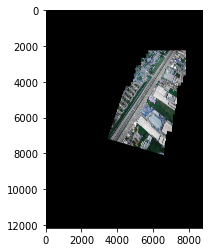

In [17]:
plt.imshow(warp_all[6])


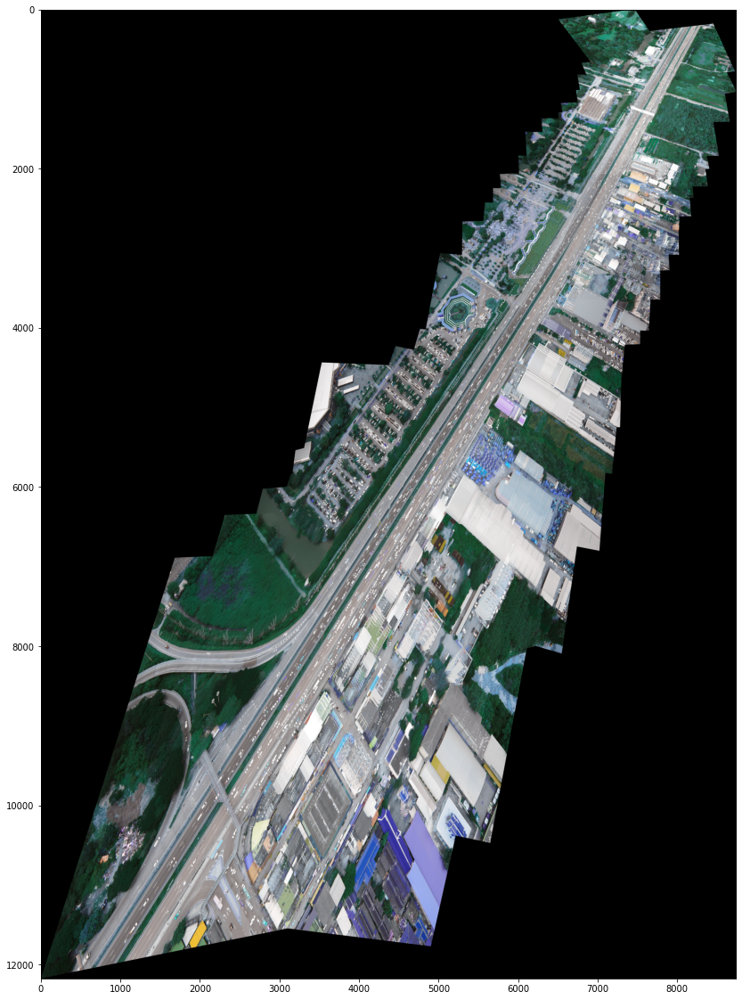

In [18]:
plt.figure(figsize = (25,20))
plt.imshow(combined_warp_n)


In [19]:
combo_rgb = cv2.cvtColor(combined_warp_n, cv2.COLOR_BGR2RGB)

Text(0.5, 1.0, '30 Images Mosaic')

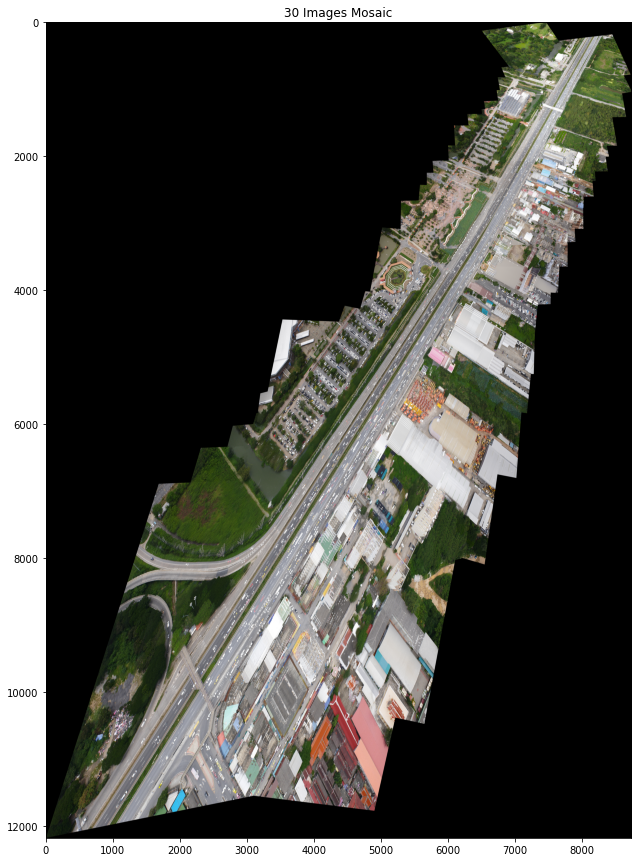

In [20]:
plt.figure(figsize = (25,15))


plt.imshow(combo_rgb)
plt.title('30 Images Mosaic')